In [ ]:
pip install pandas numpy scikit-learn tensorflow matplotlib


# Train a model on a single chute taking into account zip code and package count


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 0.1159
Epoch 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0966
Epoch 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.0793
Epoch 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 0.0643
Epoch 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step - loss: 0.0511
Epoch 6/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - loss: 0.0399
Epoch 7/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step - loss: 0.0302
Epoch 8/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step - loss: 0.0217
Epoch 9/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 0.0150
Epoch 10/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 0.0102


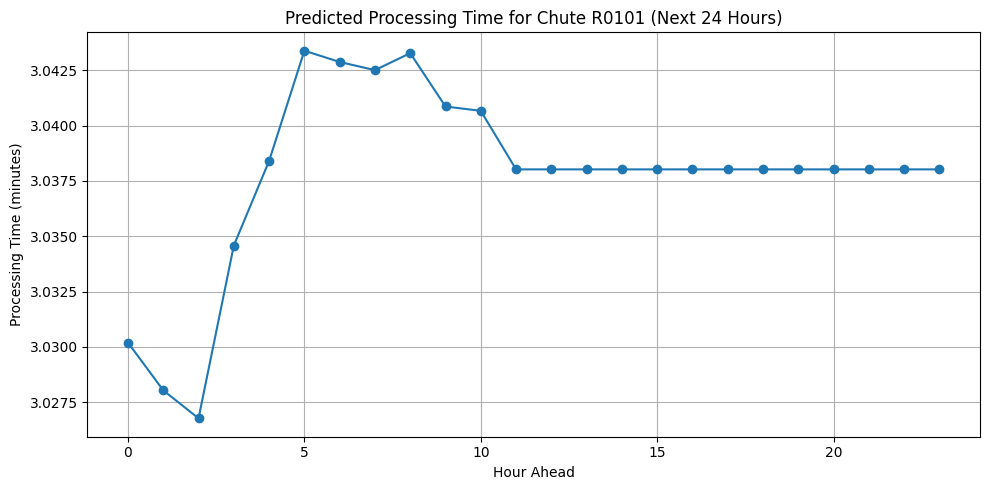

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
import matplotlib.pyplot as plt

# ========== LOAD DATA ==========
# Replace this path with your actual file path
df = pd.read_csv('data4day.csv')

# Parse datetime
df['HOUR_TIME'] = pd.to_datetime(df['HOUR_TIME'], format="%Y-%m-%d %H")

# ========== FILTER ONE CHUTE ==========
chute_id = 'R0101'  # Change this if needed
df = df[df['CHUTE'] == chute_id]

# ========== AGGREGATE DATA HOURLY ==========
df_hourly = df.groupby('HOUR_TIME').agg({
    'PACKAGE_COUNT': 'sum',
    'AVG_PROCESSING_TIME_MINUTES': 'mean'
}).reset_index()

# Use most common ZIP per hour
zip_mode = df.groupby('HOUR_TIME')['ZIP_CODE'].agg(lambda x: x.mode()[0])
df_hourly['ZIP_CODE'] = df_hourly['HOUR_TIME'].map(zip_mode)

# Add time features
df_hourly['HOUR'] = df_hourly['HOUR_TIME'].dt.hour
df_hourly['DAY_OF_WEEK'] = df_hourly['HOUR_TIME'].dt.dayofweek

# Encode ZIP code
zip_encoder = LabelEncoder()
df_hourly['ZIP_CODE_ENC'] = zip_encoder.fit_transform(df_hourly['ZIP_CODE'])

# ========== PREPARE DATA ==========
features = ['ZIP_CODE_ENC', 'PACKAGE_COUNT', 'HOUR', 'DAY_OF_WEEK']
target = 'AVG_PROCESSING_TIME_MINUTES'

# Normalize features and target
scaler_X = MinMaxScaler()
X_scaled = scaler_X.fit_transform(df_hourly[features])

scaler_y = MinMaxScaler()
y_scaled = scaler_y.fit_transform(df_hourly[[target]])

# Create time series generator
sequence_length = 12
generator = TimeseriesGenerator(X_scaled, y_scaled, length=sequence_length, batch_size=32)

# ========== BUILD & TRAIN LSTM MODEL ==========
model = Sequential()
model.add(LSTM(64, activation='relu', input_shape=(sequence_length, len(features))))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

model.fit(generator, epochs=10, verbose=1)

# ========== PREDICT NEXT 24 HOURS ==========
last_seq = X_scaled[-sequence_length:]
last_seq = np.expand_dims(last_seq, axis=0)
future_preds = []

for _ in range(24):
    pred = model.predict(last_seq, verbose=0)[0][0]
    future_preds.append(pred)

    next_input = last_seq[0][1:]  # shift left
    next_input = np.vstack([next_input, last_seq[0, -1]])  # repeat last row
    last_seq = np.expand_dims(next_input, axis=0)

# Inverse scale predictions
future_preds = scaler_y.inverse_transform(np.array(future_preds).reshape(-1, 1))

# ========== PLOT ==========
plt.figure(figsize=(10, 5))
plt.plot(future_preds, marker='o')
plt.title(f'Predicted Processing Time for Chute {chute_id} (Next 24 Hours)')
plt.xlabel('Hour Ahead')
plt.ylabel('Processing Time (minutes)')
plt.grid(True)
plt.tight_layout()
plt.show()


#Train a different model for each individual chute

/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/traine

Skipping R0113: Not enough data (12 rows)


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/traine

Skipping R3527: Not enough data (9 rows)
Skipping R3528: Not enough data (6 rows)


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/traine

Skipping R2526: Not enough data (4 rows)


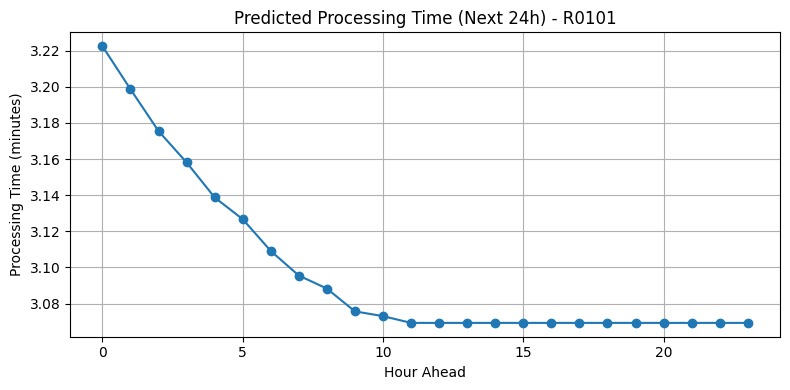

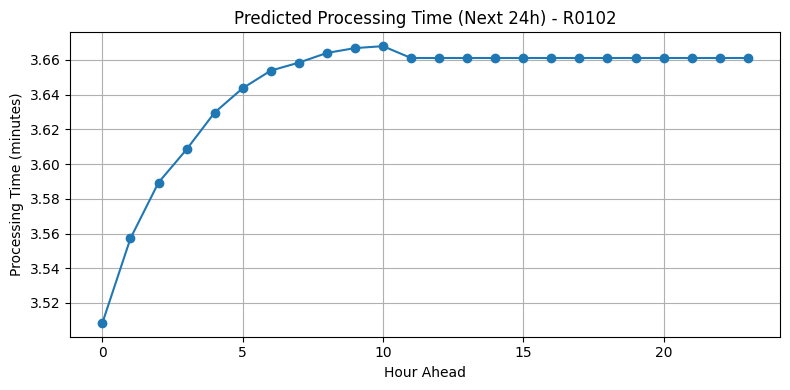

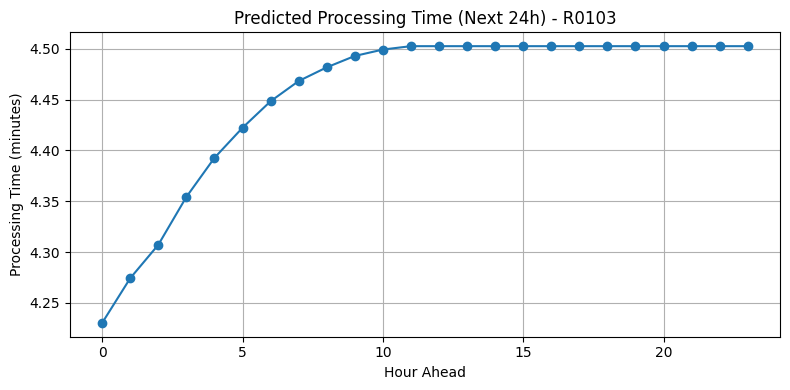

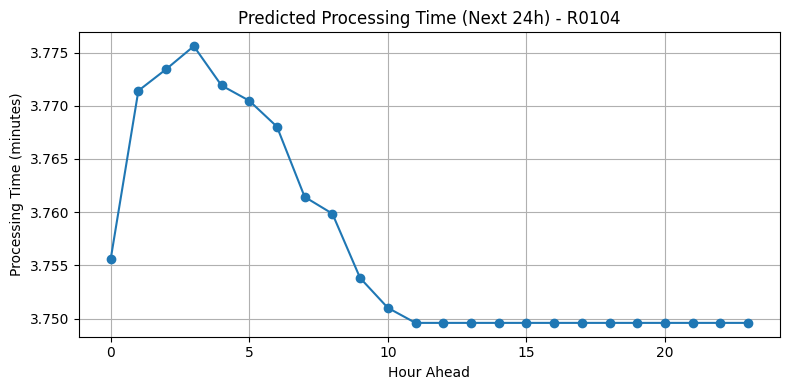

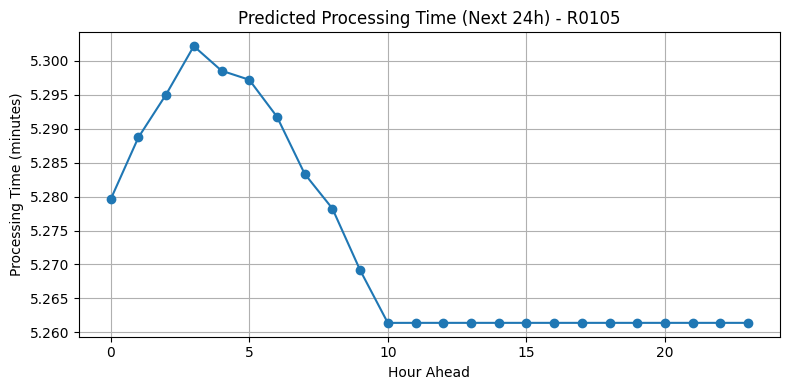

...

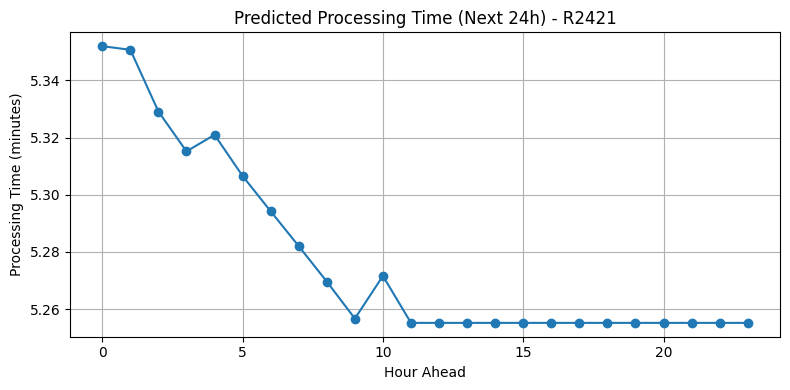

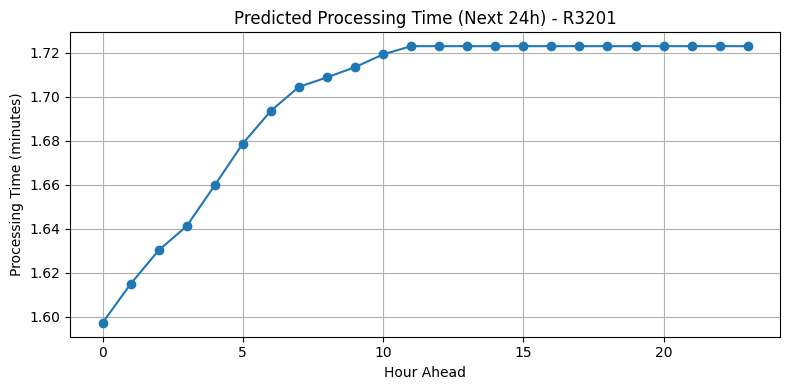

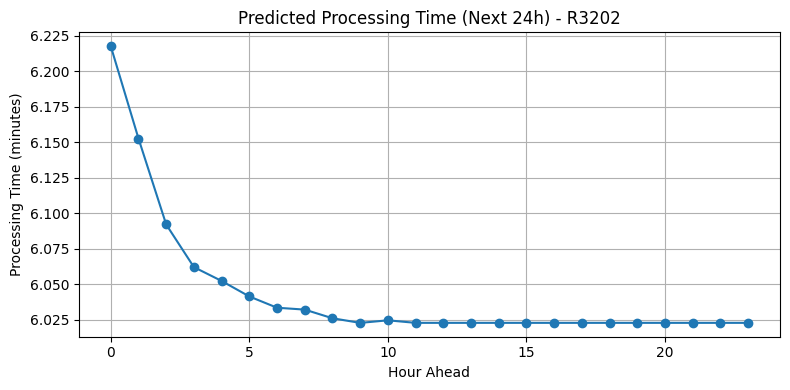

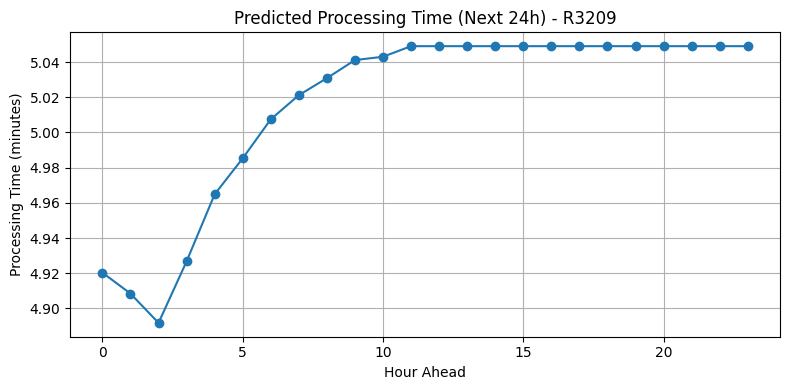

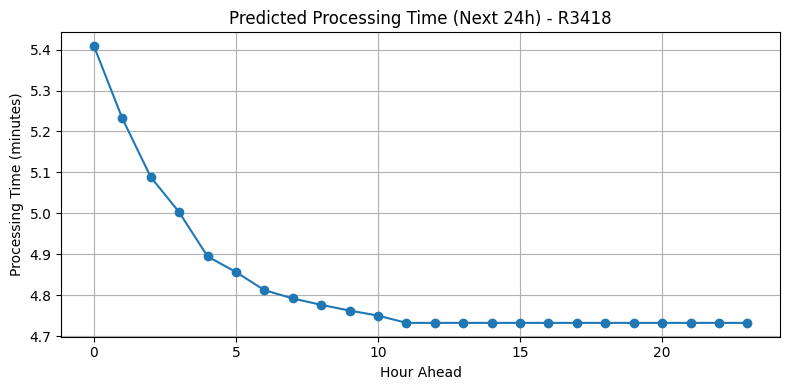

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
import matplotlib.pyplot as plt

# ========== LOAD DATA ==========
df = pd.read_csv('data4day.csv')
df['HOUR_TIME'] = pd.to_datetime(df['HOUR_TIME'], format="%Y-%m-%d %H")

# ========== GET LIST OF CHUTES ==========
chutes = df['CHUTE'].unique()
sequence_length = 12
results = {}

# ========== PROCESS EACH CHUTE ==========
for chute_id in chutes:
    df_chute = df[df['CHUTE'] == chute_id].copy()

    # Aggregate hourly
    df_hourly = df_chute.groupby('HOUR_TIME').agg({
        'PACKAGE_COUNT': 'sum',
        'AVG_PROCESSING_TIME_MINUTES': 'mean'
    }).reset_index()

    # Skip chutes with not enough data
    if len(df_hourly) <= sequence_length:
        print(f"Skipping {chute_id}: Not enough data ({len(df_hourly)} rows)")
        continue

    # Most frequent ZIP per hour
    zip_mode = df_chute.groupby('HOUR_TIME')['ZIP_CODE'].agg(lambda x: x.mode()[0])
    df_hourly['ZIP_CODE'] = df_hourly['HOUR_TIME'].map(zip_mode)

    # Time features
    df_hourly['HOUR'] = df_hourly['HOUR_TIME'].dt.hour
    df_hourly['DAY_OF_WEEK'] = df_hourly['HOUR_TIME'].dt.dayofweek

    # Encode ZIP
    zip_encoder = LabelEncoder()
    df_hourly['ZIP_CODE_ENC'] = zip_encoder.fit_transform(df_hourly['ZIP_CODE'])

    # Normalize features
    features = ['ZIP_CODE_ENC', 'PACKAGE_COUNT', 'HOUR', 'DAY_OF_WEEK']
    target = 'AVG_PROCESSING_TIME_MINUTES'

    scaler_X = MinMaxScaler()
    X_scaled = scaler_X.fit_transform(df_hourly[features])

    scaler_y = MinMaxScaler()
    y_scaled = scaler_y.fit_transform(df_hourly[[target]])

    # Time series generator
    generator = TimeseriesGenerator(X_scaled, y_scaled, length=sequence_length, batch_size=32)

    # Build and train model
    model = Sequential()
    model.add(LSTM(64, activation='relu', input_shape=(sequence_length, len(features))))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mse')
    model.fit(generator, epochs=10, verbose=0)

    # Predict next 24 hours
    last_seq = X_scaled[-sequence_length:]
    last_seq = np.expand_dims(last_seq, axis=0)
    future_preds = []

    for _ in range(24):
        pred = model.predict(last_seq, verbose=0)[0][0]
        future_preds.append(pred)

        # Simulate next input (use last known input)
        next_input = last_seq[0][1:]
        next_input = np.vstack([next_input, last_seq[0, -1]])  # repeat last row
        last_seq = np.expand_dims(next_input, axis=0)

    # Inverse transform predictions
    future_preds = scaler_y.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()
    results[chute_id] = future_preds

# ========== DISPLAY RESULTS ==========
for chute_id, preds in results.items():
    plt.figure(figsize=(8, 4))
    plt.plot(preds, marker='o')
    plt.title(f'Predicted Processing Time (Next 24h) - {chute_id}')
    plt.xlabel('Hour Ahead')
    plt.ylabel('Processing Time (minutes)')
    plt.grid(True)
    plt.tight_layout()
    plt.show()


# Multi-Chute Prediction with Threshold 10 Minutes

Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


209/209 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - loss: 0.0066
Epoch 2/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.0045
Epoch 3/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - loss: 0.0056
Epoch 4/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0051
Epoch 5/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0047
Epoch 6/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0052
Epoch 7/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0057
Epoch 8/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0050
Epoch 9/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - loss: 0.0046
Epoch 10/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - loss: 0.0054


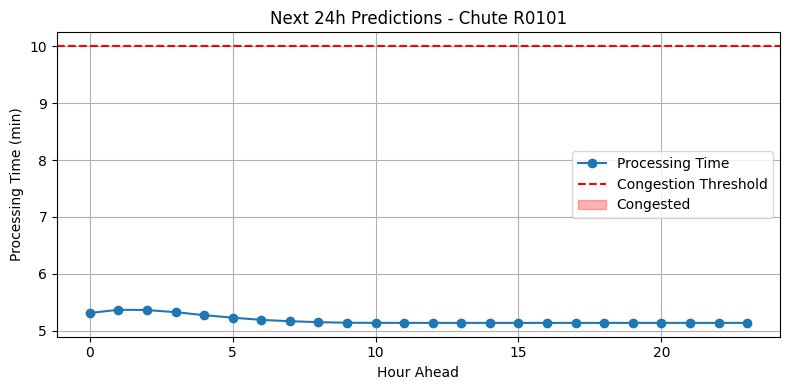

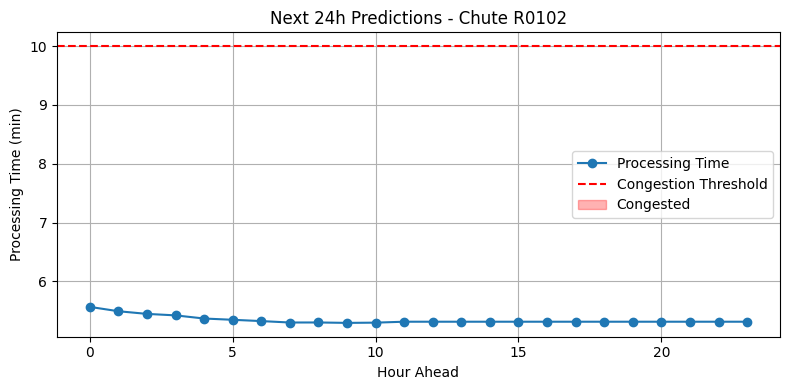

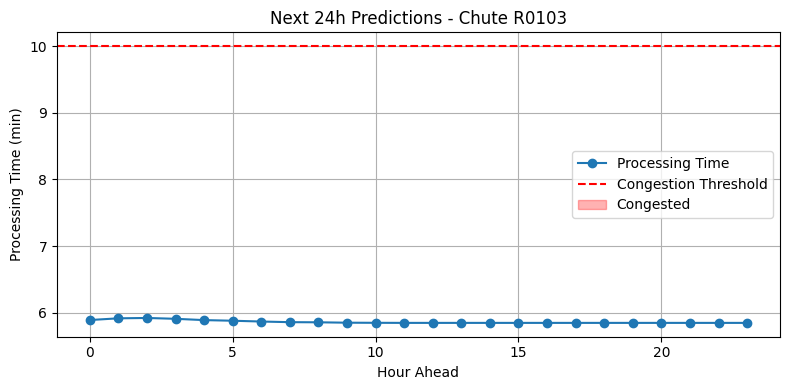

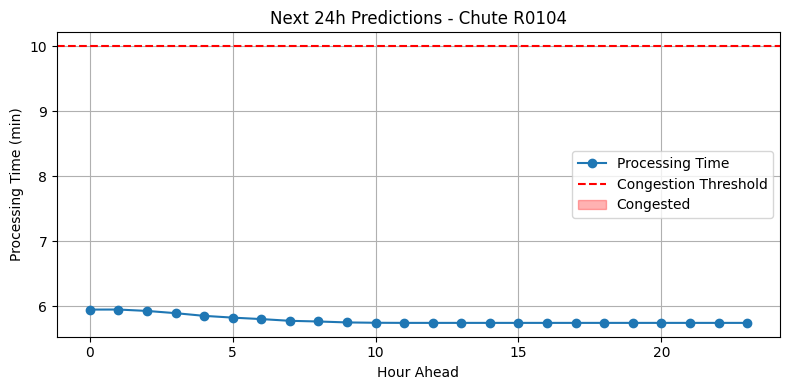

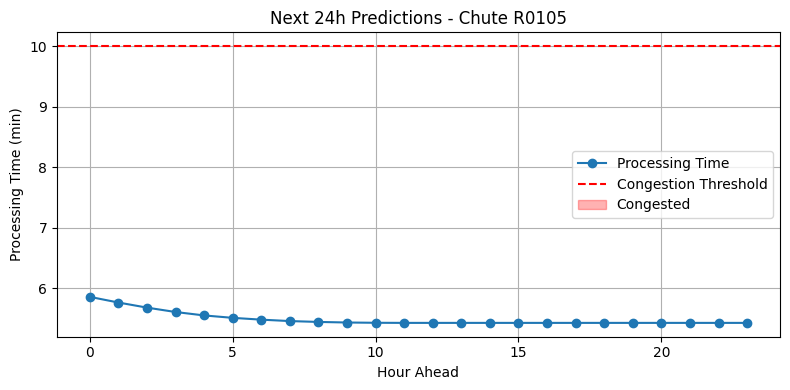

...

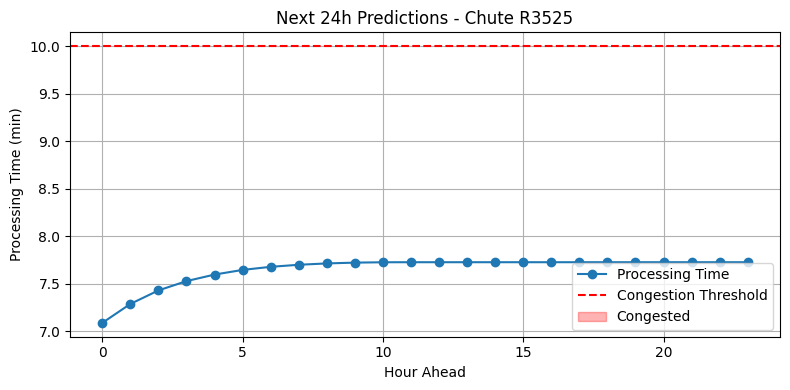

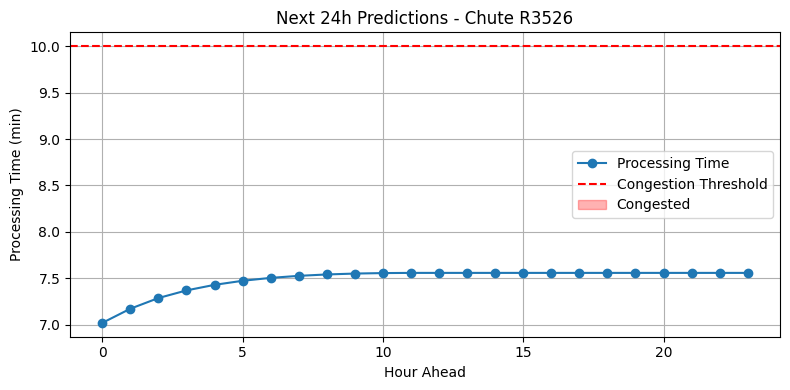

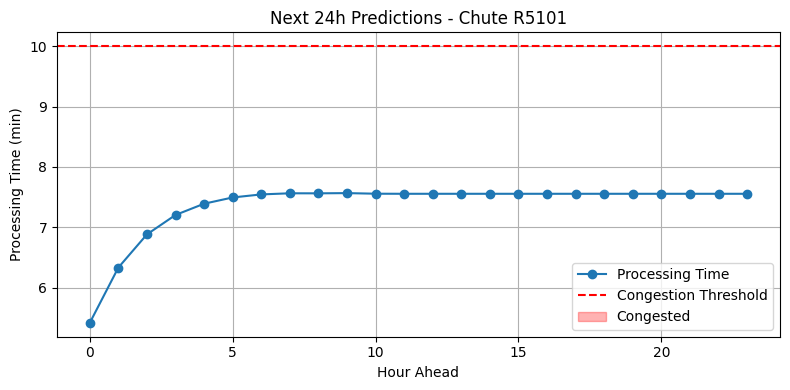

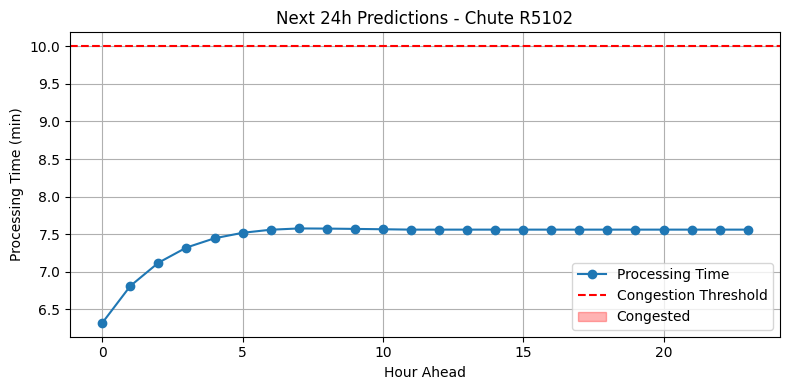

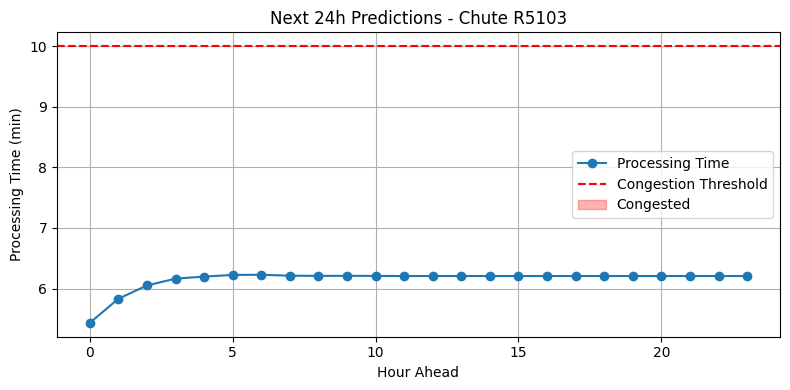

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
import matplotlib.pyplot as plt

# Load and parse data
df = pd.read_csv('data4day.csv')
df['HOUR_TIME'] = pd.to_datetime(df['HOUR_TIME'], format="%Y-%m-%d %H")

# Time features
df['HOUR'] = df['HOUR_TIME'].dt.hour
df['DAY_OF_WEEK'] = df['HOUR_TIME'].dt.dayofweek

# Encode CHUTE and ZIP_CODE
chute_encoder = LabelEncoder()
zip_encoder = LabelEncoder()
df['CHUTE_ENC'] = chute_encoder.fit_transform(df['CHUTE'])
df['ZIP_CODE_ENC'] = zip_encoder.fit_transform(df['ZIP_CODE'])

# Aggregate by chute + hour
df_hourly = df.groupby(['HOUR_TIME', 'CHUTE_ENC']).agg({
    'ZIP_CODE_ENC': lambda x: x.mode()[0] if not x.mode().empty else x.iloc[0],
    'PACKAGE_COUNT': 'sum',
    'AVG_PROCESSING_TIME_MINUTES': 'mean'
}).reset_index()

# Merge back time features
df_hourly = df_hourly.merge(df[['HOUR_TIME', 'HOUR', 'DAY_OF_WEEK']].drop_duplicates(), on='HOUR_TIME')

# Feature selection
features = ['CHUTE_ENC', 'ZIP_CODE_ENC', 'PACKAGE_COUNT', 'HOUR', 'DAY_OF_WEEK']
target = 'AVG_PROCESSING_TIME_MINUTES'

# Normalize
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()
X_scaled = scaler_X.fit_transform(df_hourly[features])
y_scaled = scaler_y.fit_transform(df_hourly[[target]])

# Time Series Generator (across all chutes)
sequence_length = 12
generator = TimeseriesGenerator(X_scaled, y_scaled, length=sequence_length, batch_size=32)

# Build model
model = Sequential()
model.add(LSTM(64, activation='relu', input_shape=(sequence_length, len(features))))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')
model.fit(generator, epochs=10, verbose=1)

# Predict for each chute separately
results = {}
congestion_threshold = 10  # minutes
for chute_enc in df_hourly['CHUTE_ENC'].unique():
    df_chute = df_hourly[df_hourly['CHUTE_ENC'] == chute_enc].copy()
    if len(df_chute) <= sequence_length:
        continue

    X_chute = scaler_X.transform(df_chute[features])
    last_seq = X_chute[-sequence_length:]
    last_seq = np.expand_dims(last_seq, axis=0)
    future_preds = []

    for _ in range(24):
        pred = model.predict(last_seq, verbose=0)[0][0]
        future_preds.append(pred)

        # Simulate next input (use last known values)
        next_input = last_seq[0][1:]
        next_input = np.vstack([next_input, last_seq[0, -1]])  # repeat last
        last_seq = np.expand_dims(next_input, axis=0)

    preds_rescaled = scaler_y.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()
    chute_id = chute_encoder.inverse_transform([chute_enc])[0]
    congestion_flags = preds_rescaled > congestion_threshold

    results[chute_id] = {
        'predictions': preds_rescaled,
        'congestion_flags': congestion_flags
    }

# Plot results
for chute_id, res in results.items():
    preds = res['predictions']
    congestion = res['congestion_flags']

    plt.figure(figsize=(8, 4))
    plt.plot(preds, marker='o', label='Processing Time')
    plt.axhline(congestion_threshold, color='red', linestyle='--', label='Congestion Threshold')
    plt.fill_between(range(24), 0, preds, where=congestion, color='red', alpha=0.3, label='Congested')
    plt.title(f'Next 24h Predictions - Chute {chute_id}')
    plt.xlabel('Hour Ahead')
    plt.ylabel('Processing Time (min)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


# Plot only congested chutes in a single plot

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
from tensorflow.keras.models import load_model
import tensorflow as tf

# Load data
df = pd.read_csv('data4day.csv')
df['HOUR_TIME'] = pd.to_datetime(df['HOUR_TIME'], format="%Y-%m-%d %H")

# Time features
df['HOUR'] = df['HOUR_TIME'].dt.hour
df['DAY_OF_WEEK'] = df['HOUR_TIME'].dt.dayofweek

# Encode CHUTE and ZIP_CODE
chute_encoder = LabelEncoder()
zip_encoder = LabelEncoder()
df['CHUTE_ENC'] = chute_encoder.fit_transform(df['CHUTE'])
df['ZIP_CODE_ENC'] = zip_encoder.fit_transform(df['ZIP_CODE'])

# Aggregate per hour per chute
df_hourly = df.groupby(['HOUR_TIME', 'CHUTE_ENC']).agg({
    'ZIP_CODE_ENC': lambda x: x.mode()[0] if not x.mode().empty else x.iloc[0],
    'PACKAGE_COUNT': 'sum',
    'AVG_PROCESSING_TIME_MINUTES': 'mean'
}).reset_index()

# Add time features
df_hourly = df_hourly.merge(df[['HOUR_TIME', 'HOUR', 'DAY_OF_WEEK']].drop_duplicates(), on='HOUR_TIME')

# Features & target
features = ['CHUTE_ENC', 'ZIP_CODE_ENC', 'PACKAGE_COUNT', 'HOUR', 'DAY_OF_WEEK']
target = 'AVG_PROCESSING_TIME_MINUTES'

# Normalize
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()
X_scaled = scaler_X.fit_transform(df_hourly[features])
y_scaled = scaler_y.fit_transform(df_hourly[[target]])

# Sequence generator
sequence_length = 12
generator = TimeseriesGenerator(X_scaled, y_scaled, length=sequence_length, batch_size=32)

# Build and train model
model = Sequential()
model.add(LSTM(64, activation='relu', input_shape=(sequence_length, len(features))))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')
model.fit(generator, epochs=10, verbose=1)

# Save model
model.save('multi_chute_congestion_model.h5')
print("✅ Model saved as 'multi_chute_congestion_model.h5'")

# Prediction for each chute
congestion_threshold = 10
results = {}

for chute_enc in df_hourly['CHUTE_ENC'].unique():
    df_chute = df_hourly[df_hourly['CHUTE_ENC'] == chute_enc].copy()
    if len(df_chute) <= sequence_length:
        continue

    X_chute = scaler_X.transform(df_chute[features])
    last_seq = X_chute[-sequence_length:]
    last_seq = np.expand_dims(last_seq, axis=0)
    future_preds = []

    for _ in range(24):
        pred = model.predict(last_seq, verbose=0)[0][0]
        future_preds.append(pred)

        next_input = last_seq[0][1:]
        next_input = np.vstack([next_input, last_seq[0, -1]])  # repeat last
        last_seq = np.expand_dims(next_input, axis=0)

    preds_rescaled = scaler_y.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()
    chute_id = chute_encoder.inverse_transform([chute_enc])[0]
    congestion_flags = preds_rescaled > congestion_threshold

    if np.any(congestion_flags):
        results[chute_id] = preds_rescaled

# Plot all congested chutes on one plot
if results:
    plt.figure(figsize=(12, 6))
    for chute_id, preds in results.items():
        plt.plot(preds, label=f'Chute {chute_id}')
    plt.axhline(congestion_threshold, color='red', linestyle='--', label='Congestion Threshold')
    plt.title('Predicted Processing Time (Next 24 Hours) - Congested Chutes Only')
    plt.xlabel('Hour Ahead')
    plt.ylabel('Processing Time (min)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("✅ No chutes predicted to exceed congestion threshold.")


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


209/209 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - loss: 0.0061
Epoch 2/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - loss: 0.0060
Epoch 3/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - loss: 0.0058
Epoch 4/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0050
Epoch 5/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step - loss: 0.0043
Epoch 6/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0059
Epoch 7/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - loss: 0.0045
Epoch 8/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0052
Epoch 9/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - loss: 0.0056
Epoch 10/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0042


✅ Model saved as 'multi_chute_congestion_model.h5'
✅ No chutes predicted to exceed congestion threshold.


# Same but with Threshold = 7.5 mins

Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


209/209 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0071
Epoch 2/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0061
Epoch 3/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0048
Epoch 4/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - loss: 0.0057
Epoch 5/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0056
Epoch 6/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0059
Epoch 7/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0048
Epoch 8/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0047
Epoch 9/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0055
Epoch 10/10
209/209 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - loss: 0.0051


✅ Model saved as 'multi_chute_congestion_model.h5'


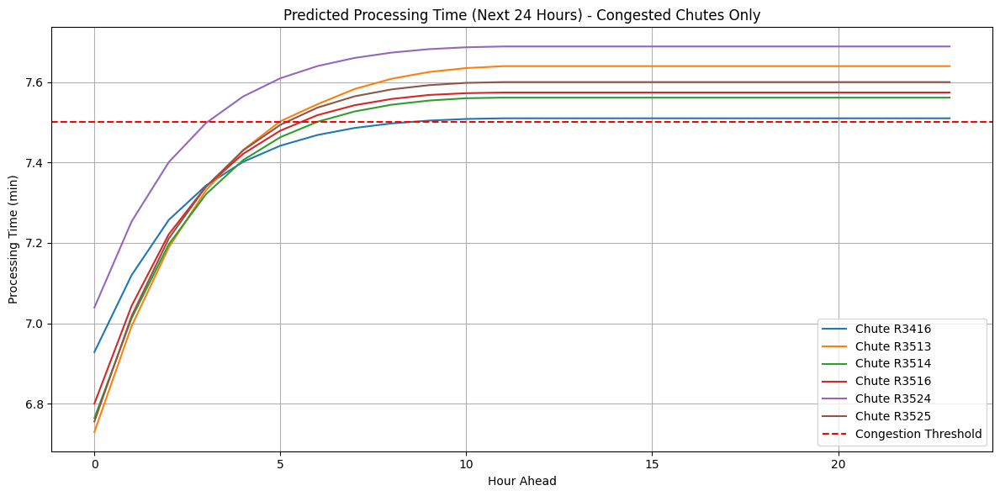

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
from tensorflow.keras.models import load_model
import tensorflow as tf

# Load data
df = pd.read_csv('data4day.csv')
df['HOUR_TIME'] = pd.to_datetime(df['HOUR_TIME'], format="%Y-%m-%d %H")

# Time features
df['HOUR'] = df['HOUR_TIME'].dt.hour
df['DAY_OF_WEEK'] = df['HOUR_TIME'].dt.dayofweek

# Encode CHUTE and ZIP_CODE
chute_encoder = LabelEncoder()
zip_encoder = LabelEncoder()
df['CHUTE_ENC'] = chute_encoder.fit_transform(df['CHUTE'])
df['ZIP_CODE_ENC'] = zip_encoder.fit_transform(df['ZIP_CODE'])

# Aggregate per hour per chute
df_hourly = df.groupby(['HOUR_TIME', 'CHUTE_ENC']).agg({
    'ZIP_CODE_ENC': lambda x: x.mode()[0] if not x.mode().empty else x.iloc[0],
    'PACKAGE_COUNT': 'sum',
    'AVG_PROCESSING_TIME_MINUTES': 'mean'
}).reset_index()

# Add time features
df_hourly = df_hourly.merge(df[['HOUR_TIME', 'HOUR', 'DAY_OF_WEEK']].drop_duplicates(), on='HOUR_TIME')

# Features & target
features = ['CHUTE_ENC', 'ZIP_CODE_ENC', 'PACKAGE_COUNT', 'HOUR', 'DAY_OF_WEEK']
target = 'AVG_PROCESSING_TIME_MINUTES'

# Normalize
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()
X_scaled = scaler_X.fit_transform(df_hourly[features])
y_scaled = scaler_y.fit_transform(df_hourly[[target]])

# Sequence generator
sequence_length = 12
generator = TimeseriesGenerator(X_scaled, y_scaled, length=sequence_length, batch_size=32)

# Build and train model
model = Sequential()
model.add(LSTM(64, activation='relu', input_shape=(sequence_length, len(features))))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')
model.fit(generator, epochs=10, verbose=1)

# Save model
model.save('multi_chute_congestion_model.h5')
print("✅ Model saved as 'multi_chute_congestion_model.h5'")

# Prediction for each chute
congestion_threshold = 7.5
results = {}

for chute_enc in df_hourly['CHUTE_ENC'].unique():
    df_chute = df_hourly[df_hourly['CHUTE_ENC'] == chute_enc].copy()
    if len(df_chute) <= sequence_length:
        continue

    X_chute = scaler_X.transform(df_chute[features])
    last_seq = X_chute[-sequence_length:]
    last_seq = np.expand_dims(last_seq, axis=0)
    future_preds = []

    for _ in range(24):
        pred = model.predict(last_seq, verbose=0)[0][0]
        future_preds.append(pred)

        next_input = last_seq[0][1:]
        next_input = np.vstack([next_input, last_seq[0, -1]])  # repeat last
        last_seq = np.expand_dims(next_input, axis=0)

    preds_rescaled = scaler_y.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()
    chute_id = chute_encoder.inverse_transform([chute_enc])[0]
    congestion_flags = preds_rescaled > congestion_threshold

    if np.any(congestion_flags):
        results[chute_id] = preds_rescaled

# Plot all congested chutes on one plot
if results:
    plt.figure(figsize=(12, 6))
    for chute_id, preds in results.items():
        plt.plot(preds, label=f'Chute {chute_id}')
    plt.axhline(congestion_threshold, color='red', linestyle='--', label='Congestion Threshold')
    plt.title('Predicted Processing Time (Next 24 Hours) - Congested Chutes Only')
    plt.xlabel('Hour Ahead')
    plt.ylabel('Processing Time (min)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("✅ No chutes predicted to exceed congestion threshold.")


# Using Pytorch instead of Keras

Epoch 5/20, Loss: 0.0112
Epoch 10/20, Loss: 0.0159
Epoch 15/20, Loss: 0.0076
Epoch 20/20, Loss: 0.0086


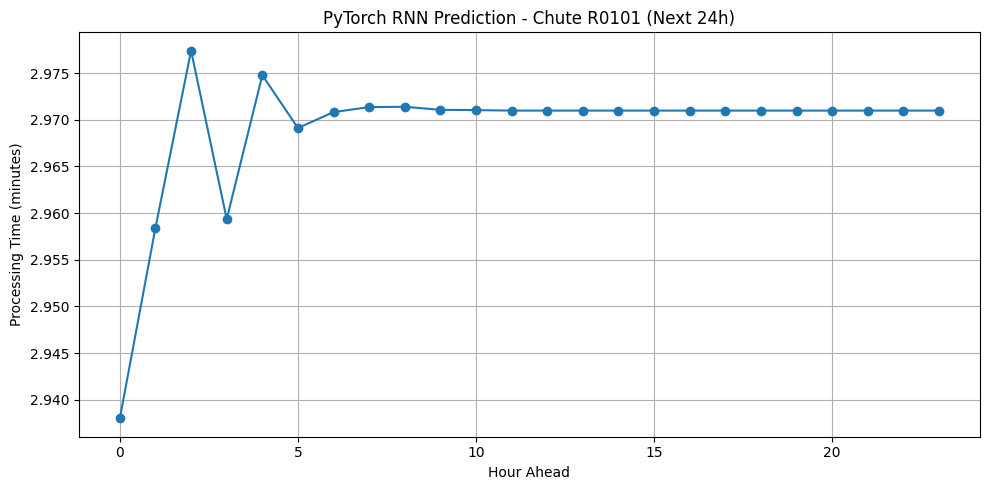

In [ ]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
import matplotlib.pyplot as plt

# ========== CONFIG ==========
CHUTE_ID = 'R0101'
SEQUENCE_LENGTH = 12
PREDICTION_HORIZON = 24
EPOCHS = 20
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

# ========== LOAD DATA ==========
df = pd.read_csv('data4day.csv')
df['HOUR_TIME'] = pd.to_datetime(df['HOUR_TIME'], format="%Y-%m-%d %H")
df = df[df['CHUTE'] == CHUTE_ID]

# ========== AGGREGATE HOURLY ==========
df_hourly = df.groupby('HOUR_TIME').agg({
    'PACKAGE_COUNT': 'sum',
    'AVG_PROCESSING_TIME_MINUTES': 'mean'
}).reset_index()

# Most frequent ZIP per hour
zip_mode = df.groupby('HOUR_TIME')['ZIP_CODE'].agg(lambda x: x.mode()[0])
df_hourly['ZIP_CODE'] = df_hourly['HOUR_TIME'].map(zip_mode)

# Encode ZIP
zip_encoder = LabelEncoder()
df_hourly['ZIP_CODE_ENC'] = zip_encoder.fit_transform(df_hourly['ZIP_CODE'])

# Features and target
features = ['ZIP_CODE_ENC', 'PACKAGE_COUNT']
target = 'AVG_PROCESSING_TIME_MINUTES'

# Normalize
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()
X_scaled = scaler_X.fit_transform(df_hourly[features])
y_scaled = scaler_y.fit_transform(df_hourly[[target]])

# Create sequences
def create_sequences(X, y, seq_len):
    X_seq, y_seq = [], []
    for i in range(len(X) - seq_len):
        X_seq.append(X[i:i+seq_len])
        y_seq.append(y[i+seq_len])
    return np.array(X_seq), np.array(y_seq)

X_seq, y_seq = create_sequences(X_scaled, y_scaled, SEQUENCE_LENGTH)

# Convert to PyTorch tensors
X_tensor = torch.tensor(X_seq, dtype=torch.float32).to(DEVICE)
y_tensor = torch.tensor(y_seq, dtype=torch.float32).to(DEVICE)

# ========== DEFINE RNN MODEL ==========
class RNNModel(nn.Module):
    def __init__(self, input_size, hidden_size=64):
        super(RNNModel, self).__init__()
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, 1)

    def forward(self, x):
        out, _ = self.rnn(x)
        last = out[:, -1, :]
        return self.fc(last)

model = RNNModel(input_size=X_tensor.shape[2]).to(DEVICE)
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# ========== TRAIN ==========
for epoch in range(EPOCHS):
    model.train()
    optimizer.zero_grad()
    output = model(X_tensor)
    loss = loss_fn(output, y_tensor)
    loss.backward()
    optimizer.step()
    if (epoch + 1) % 5 == 0:
        print(f"Epoch {epoch+1}/{EPOCHS}, Loss: {loss.item():.4f}")

# ========== PREDICT NEXT 24 HOURS ==========
model.eval()
last_seq = X_scaled[-SEQUENCE_LENGTH:]
last_seq = torch.tensor(last_seq, dtype=torch.float32).unsqueeze(0).to(DEVICE)

future_preds = []

for _ in range(PREDICTION_HORIZON):
    with torch.no_grad():
        pred = model(last_seq).item()
        future_preds.append(pred)
        next_input = last_seq[0, 1:, :].cpu().numpy()
        last_step = last_seq[0, -1, :].cpu().numpy()  # You could simulate smarter changes
        next_input = np.vstack([next_input, last_step])  # repeat last step
        last_seq = torch.tensor(next_input, dtype=torch.float32).unsqueeze(0).to(DEVICE)

# ========== INVERSE TRANSFORM & PLOT ==========
future_preds = scaler_y.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()

plt.figure(figsize=(10, 5))
plt.plot(future_preds, marker='o')
plt.title(f"PyTorch RNN Prediction - Chute {CHUTE_ID} (Next 24h)")
plt.xlabel("Hour Ahead")
plt.ylabel("Processing Time (minutes)")
plt.grid(True)
plt.tight_layout()
plt.show()


# Do Multi-chute Prediction with threshold = 7.5 min

Epoch 5/20, Loss: 0.0058
Epoch 10/20, Loss: 0.0054
Epoch 15/20, Loss: 0.0052
Epoch 20/20, Loss: 0.0051
✅ Model saved to 'multi_chute_rnn_model.pt'


<ipython-input-5-8fdbb312dcca>:139: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


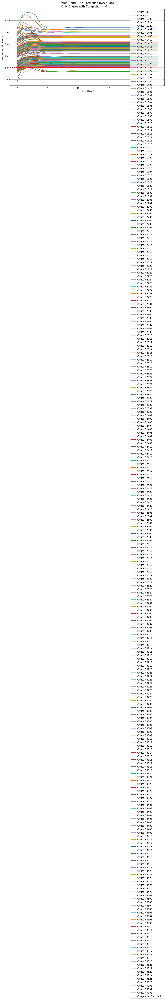

In [ ]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from datetime import timedelta

# ========== CONFIG ==========
SEQUENCE_LENGTH = 12
PREDICTION_HORIZON = 24
EPOCHS = 20
CONGESTION_THRESHOLD = 6
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
MODEL_SAVE_PATH = 'multi_chute_rnn_model.pt'

# ========== LOAD DATA ==========
df = pd.read_csv('data4day.csv')
df['HOUR_TIME'] = pd.to_datetime(df['HOUR_TIME'], format="%Y-%m-%d %H")

# Time features
df['HOUR'] = df['HOUR_TIME'].dt.hour
df['DAY_OF_WEEK'] = df['HOUR_TIME'].dt.dayofweek

# Encode CHUTE and ZIP
chute_encoder = LabelEncoder()
zip_encoder = LabelEncoder()
df['CHUTE_ENC'] = chute_encoder.fit_transform(df['CHUTE'])
df['ZIP_CODE_ENC'] = zip_encoder.fit_transform(df['ZIP_CODE'])

# Aggregate hourly data per chute
df_hourly = df.groupby(['HOUR_TIME', 'CHUTE_ENC']).agg({
    'ZIP_CODE_ENC': lambda x: x.mode()[0] if not x.mode().empty else x.iloc[0],
    'PACKAGE_COUNT': 'sum',
    'AVG_PROCESSING_TIME_MINUTES': 'mean'
}).reset_index()

# Add time features back
df_hourly = df_hourly.merge(
    df[['HOUR_TIME', 'HOUR', 'DAY_OF_WEEK']].drop_duplicates(),
    on='HOUR_TIME'
)

# Features and target
features = ['CHUTE_ENC', 'ZIP_CODE_ENC', 'PACKAGE_COUNT', 'HOUR', 'DAY_OF_WEEK']
target = 'AVG_PROCESSING_TIME_MINUTES'

# Normalize
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()
X_scaled = scaler_X.fit_transform(df_hourly[features])
y_scaled = scaler_y.fit_transform(df_hourly[[target]])

# Create sequences
def create_sequences(X, y, seq_len):
    X_seq, y_seq = [], []
    for i in range(len(X) - seq_len):
        X_seq.append(X[i:i+seq_len])
        y_seq.append(y[i+seq_len])
    return np.array(X_seq), np.array(y_seq)

X_seq, y_seq = create_sequences(X_scaled, y_scaled, SEQUENCE_LENGTH)

# Convert to tensors
X_tensor = torch.tensor(X_seq, dtype=torch.float32).to(DEVICE)
y_tensor = torch.tensor(y_seq, dtype=torch.float32).to(DEVICE)

# ========== RNN MODEL ==========
class RNNModel(nn.Module):
    def __init__(self, input_size, hidden_size=64):
        super(RNNModel, self).__init__()
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, 1)

    def forward(self, x):
        out, _ = self.rnn(x)
        last = out[:, -1, :]
        return self.fc(last)

model = RNNModel(input_size=X_tensor.shape[2]).to(DEVICE)
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# ========== TRAIN ==========
for epoch in range(EPOCHS):
    model.train()
    optimizer.zero_grad()
    pred = model(X_tensor)
    loss = loss_fn(pred, y_tensor)
    loss.backward()
    optimizer.step()
    if (epoch + 1) % 5 == 0:
        print(f"Epoch {epoch+1}/{EPOCHS}, Loss: {loss.item():.4f}")

# Save model
torch.save(model.state_dict(), MODEL_SAVE_PATH)
print(f"✅ Model saved to '{MODEL_SAVE_PATH}'")

# ========== PREDICT FOR EACH CHUTE ==========
results = {}
for chute_enc in df_hourly['CHUTE_ENC'].unique():
    df_chute = df_hourly[df_hourly['CHUTE_ENC'] == chute_enc].copy()
    if len(df_chute) <= SEQUENCE_LENGTH:
        continue

    X_chute = scaler_X.transform(df_chute[features])
    last_seq = X_chute[-SEQUENCE_LENGTH:]
    last_seq = torch.tensor(last_seq, dtype=torch.float32).unsqueeze(0).to(DEVICE)

    future_preds = []
    for _ in range(PREDICTION_HORIZON):
        with torch.no_grad():
            pred = model(last_seq).item()
            future_preds.append(pred)

        # Simulate next input (repeat last row)
        next_input = last_seq[0, 1:, :].cpu().numpy()
        last_row = last_seq[0, -1, :].cpu().numpy()
        next_input = np.vstack([next_input, last_row])
        last_seq = torch.tensor(next_input, dtype=torch.float32).unsqueeze(0).to(DEVICE)

    preds_rescaled = scaler_y.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()
    chute_id = chute_encoder.inverse_transform([chute_enc])[0]

    if np.any(preds_rescaled > CONGESTION_THRESHOLD):
        results[chute_id] = preds_rescaled

# ========== PLOT ONLY CONGESTED CHUTES ==========
if results:
    plt.figure(figsize=(12, 6))
    for chute_id, preds in results.items():
        plt.plot(preds, label=f'Chute {chute_id}')
    plt.axhline(CONGESTION_THRESHOLD, color='red', linestyle='--', label='Congestion Threshold')
    plt.title(f"Multi-Chute RNN Prediction (Next 24h)\nOnly Chutes with Congestion > {CONGESTION_THRESHOLD} min")
    plt.xlabel("Hour Ahead")
    plt.ylabel("Processing Time (min)")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("✅ No chutes are predicted to exceed the congestion threshold.")


#LSTM for more variation and less predicting means


Epoch 5/20, Loss: 0.0303
Epoch 10/20, Loss: 0.0081
Epoch 15/20, Loss: 0.0078
Epoch 20/20, Loss: 0.0077
✅ LSTM model saved to 'multi_chute_lstm_model.pt'


<ipython-input-7-9fbe4d2ef4af>:138: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


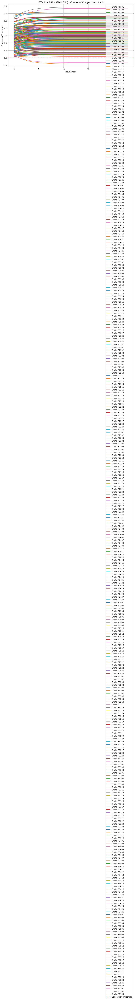

In [ ]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler, LabelEncoder

# ========== CONFIG ==========
SEQUENCE_LENGTH = 12
PREDICTION_HORIZON = 24
EPOCHS = 20
CONGESTION_THRESHOLD = 6
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
MODEL_SAVE_PATH = 'multi_chute_lstm_model.pt'

# ========== LOAD DATA ==========
df = pd.read_csv('data4day.csv')
df['HOUR_TIME'] = pd.to_datetime(df['HOUR_TIME'], format="%Y-%m-%d %H")

# Time features
df['HOUR'] = df['HOUR_TIME'].dt.hour
df['DAY_OF_WEEK'] = df['HOUR_TIME'].dt.dayofweek

# Encode CHUTE and ZIP
chute_encoder = LabelEncoder()
zip_encoder = LabelEncoder()
df['CHUTE_ENC'] = chute_encoder.fit_transform(df['CHUTE'])
df['ZIP_CODE_ENC'] = zip_encoder.fit_transform(df['ZIP_CODE'])

# Aggregate hourly data per chute
df_hourly = df.groupby(['HOUR_TIME', 'CHUTE_ENC']).agg({
    'ZIP_CODE_ENC': lambda x: x.mode()[0] if not x.mode().empty else x.iloc[0],
    'PACKAGE_COUNT': 'sum',
    'AVG_PROCESSING_TIME_MINUTES': 'mean'
}).reset_index()

# Add time features back
df_hourly = df_hourly.merge(
    df[['HOUR_TIME', 'HOUR', 'DAY_OF_WEEK']].drop_duplicates(),
    on='HOUR_TIME'
)

# Features and target
features = ['CHUTE_ENC', 'ZIP_CODE_ENC', 'PACKAGE_COUNT', 'HOUR', 'DAY_OF_WEEK']
target = 'AVG_PROCESSING_TIME_MINUTES'

# Normalize
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()
X_scaled = scaler_X.fit_transform(df_hourly[features])
y_scaled = scaler_y.fit_transform(df_hourly[[target]])

# Create sequences
def create_sequences(X, y, seq_len):
    X_seq, y_seq = [], []
    for i in range(len(X) - seq_len):
        X_seq.append(X[i:i+seq_len])
        y_seq.append(y[i+seq_len])
    return np.array(X_seq), np.array(y_seq)

X_seq, y_seq = create_sequences(X_scaled, y_scaled, SEQUENCE_LENGTH)

# Convert to tensors
X_tensor = torch.tensor(X_seq, dtype=torch.float32).to(DEVICE)
y_tensor = torch.tensor(y_seq, dtype=torch.float32).to(DEVICE)

# ========== LSTM MODEL ==========
class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size=64):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, 1)

    def forward(self, x):
        out, (hn, cn) = self.lstm(x)
        last = out[:, -1, :]
        return self.fc(last)

model = LSTMModel(input_size=X_tensor.shape[2]).to(DEVICE)
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# ========== TRAIN ==========
for epoch in range(EPOCHS):
    model.train()
    optimizer.zero_grad()
    pred = model(X_tensor)
    loss = loss_fn(pred, y_tensor)
    loss.backward()
    optimizer.step()
    if (epoch + 1) % 5 == 0:
        print(f"Epoch {epoch+1}/{EPOCHS}, Loss: {loss.item():.4f}")

# Save model
torch.save(model.state_dict(), MODEL_SAVE_PATH)
print(f"✅ LSTM model saved to '{MODEL_SAVE_PATH}'")

# ========== PREDICT FOR EACH CHUTE ==========
results = {}
for chute_enc in df_hourly['CHUTE_ENC'].unique():
    df_chute = df_hourly[df_hourly['CHUTE_ENC'] == chute_enc].copy()
    if len(df_chute) <= SEQUENCE_LENGTH:
        continue

    X_chute = scaler_X.transform(df_chute[features])
    last_seq = X_chute[-SEQUENCE_LENGTH:]
    last_seq = torch.tensor(last_seq, dtype=torch.float32).unsqueeze(0).to(DEVICE)

    future_preds = []
    for _ in range(PREDICTION_HORIZON):
        with torch.no_grad():
            pred = model(last_seq).item()
            future_preds.append(pred)

        # Repeat last step as future input
        next_input = last_seq[0, 1:, :].cpu().numpy()
        last_row = last_seq[0, -1, :].cpu().numpy()
        next_input = np.vstack([next_input, last_row])
        last_seq = torch.tensor(next_input, dtype=torch.float32).unsqueeze(0).to(DEVICE)

    preds_rescaled = scaler_y.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()
    chute_id = chute_encoder.inverse_transform([chute_enc])[0]

    if np.any(preds_rescaled > CONGESTION_THRESHOLD):
        results[chute_id] = preds_rescaled

# ========== PLOT ONLY CONGESTED CHUTES ==========
if results:
    plt.figure(figsize=(12, 6))
    for chute_id, preds in results.items():
        plt.plot(preds, label=f'Chute {chute_id}')
    plt.axhline(CONGESTION_THRESHOLD, color='red', linestyle='--', label='Congestion Threshold')
    plt.title(f"LSTM Prediction (Next 24h) - Chutes w/ Congestion > {CONGESTION_THRESHOLD} min")
    plt.xlabel("Hour Ahead")
    plt.ylabel("Processing Time (min)")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("✅ No chutes are predicted to exceed the congestion threshold.")


# Enriched Dataset with Lag

In [ ]:
import pandas as pd

# Load the raw dataset
df = pd.read_csv('data4day.csv')
df['HOUR_TIME'] = pd.to_datetime(df['HOUR_TIME'], format="%Y-%m-%d %H")

# Sort data for time-series consistency
df.sort_values(by=['CHUTE', 'HOUR_TIME'], inplace=True)

# Add time-based features
df['HOUR'] = df['HOUR_TIME'].dt.hour
df['DAY_OF_WEEK'] = df['HOUR_TIME'].dt.dayofweek

# Define lag and rolling windows
lag_features = [1, 2, 3]
rolling_windows = [3, 6]

# Initialize enriched dataset
enriched_df = df.copy()

# Apply lag and rolling features per chute
for chute in enriched_df['CHUTE'].unique():
    chute_df = enriched_df[enriched_df['CHUTE'] == chute].copy()

    for lag in lag_features:
        enriched_df.loc[enriched_df['CHUTE'] == chute, f'PACKAGE_COUNT_LAG_{lag}'] = chute_df['PACKAGE_COUNT'].shift(lag)
        enriched_df.loc[enriched_df['CHUTE'] == chute, f'PROCESSING_TIME_LAG_{lag}'] = chute_df['AVG_PROCESSING_TIME_MINUTES'].shift(lag)

    for window in rolling_windows:
        enriched_df.loc[enriched_df['CHUTE'] == chute, f'PACKAGE_COUNT_ROLL_MEAN_{window}'] = chute_df['PACKAGE_COUNT'].rolling(window).mean()
        enriched_df.loc[enriched_df['CHUTE'] == chute, f'PROCESSING_TIME_ROLL_MEAN_{window}'] = chute_df['AVG_PROCESSING_TIME_MINUTES'].rolling(window).mean()

# Drop rows with missing values introduced by lag/rolling
enriched_df.dropna(inplace=True)




In [ ]:
import pandas as pd

# Load the updated enriched dataset
#enriched_df = pd.read_csv('Updated_Enriched_DataFrame.csv')

# Convert time column to datetime
enriched_df['HOUR_TIME'] = pd.to_datetime(enriched_df['HOUR_TIME'], format="%Y-%m-%d %H:%M:%S")

# Show basic info and head
enriched_df.info(), enriched_df.head()


<class 'pandas.core.frame.DataFrame'>
Index: 142706 entries, 5 to 144173
Data columns (total 18 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   HOUR_TIME                    142706 non-null  datetime64[ns]
 1   CODS_ZENT_NR                 142706 non-null  int64         
 2   CHUTE                        142706 non-null  object        
 3   ZIP_CODE                     142706 non-null  int64         
 4   PACKAGE_COUNT                142706 non-null  int64         
 5   AVG_PROCESSING_TIME_MINUTES  142706 non-null  float64       
 6   HOUR                         142706 non-null  int32         
 7   DAY_OF_WEEK                  142706 non-null  int32         
 8   PACKAGE_COUNT_LAG_1          142706 non-null  float64       
 9   PROCESSING_TIME_LAG_1        142706 non-null  float64       
 10  PACKAGE_COUNT_LAG_2          142706 non-null  float64       
 11  PROCESSING_TIME_LAG_2        14

(None,
             HOUR_TIME  CODS_ZENT_NR  CHUTE  ZIP_CODE  PACKAGE_COUNT  \
 5 2025-03-18 18:00:00             2  R0101    804400              4   
 6 2025-03-18 18:00:00             2  R0101    804600              5   
 7 2025-03-18 18:00:00             2  R0101    804900              2   
 8 2025-03-18 18:00:00             2  R0101    805000             16   
 9 2025-03-18 18:00:00             2  R0101    805100              9   
 
    AVG_PROCESSING_TIME_MINUTES  HOUR  DAY_OF_WEEK  PACKAGE_COUNT_LAG_1  \
 5                     1.337500    18            1                  4.0   
 6                     1.560000    18            1                  4.0   
 7                     1.283333    18            1                  5.0   
 8                     1.551042    18            1                  2.0   
 9                     1.520370    18            1                 16.0   
 
    PROCESSING_TIME_LAG_1  PACKAGE_COUNT_LAG_2  PROCESSING_TIME_LAG_2  \
 5               1.662500         

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler, LabelEncoder

# === Load and Parse CSV ===

enriched_df['HOUR_TIME'] = pd.to_datetime(enriched_df['HOUR_TIME'], format="%Y-%m-%d %H:%M:%S")

# === Encode Categorical Features ===
chute_encoder = LabelEncoder()
zip_encoder = LabelEncoder()
enriched_df['CHUTE_ENC'] = chute_encoder.fit_transform(enriched_df['CHUTE'])
enriched_df['ZIP_CODE_ENC'] = zip_encoder.fit_transform(enriched_df['ZIP_CODE'])

# === Define Feature Set ===
lag_roll_features = [col for col in enriched_df.columns if 'LAG' in col or 'ROLL_MEAN' in col]
final_features = ['CHUTE_ENC', 'ZIP_CODE_ENC', 'PACKAGE_COUNT', 'HOUR', 'DAY_OF_WEEK'] + lag_roll_features
target_col = 'AVG_PROCESSING_TIME_MINUTES'

# === Drop any rows with missing values ===
df_clean = enriched_df.dropna(subset=final_features + [target_col]).copy()

# === Normalize Features and Target ===
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(df_clean[final_features])
y_scaled = scaler_y.fit_transform(df_clean[[target_col]])

# === Create Sequences for LSTM ===
def create_sequences(X, y, seq_len=12):
    X_seq, y_seq = [], []
    for i in range(len(X) - seq_len):
        X_seq.append(X[i:i+seq_len])
        y_seq.append(y[i+seq_len])
    return np.array(X_seq), np.array(y_seq)

X_seq, y_seq = create_sequences(X_scaled, y_scaled, seq_len=12)

# === Print Results ===
print(f"✅ Data Ready: {X_seq.shape[0]} samples, each with {X_seq.shape[1]} time steps and {X_seq.shape[2]} features.")


✅ Data Ready: 142694 samples, each with 12 time steps and 15 features.


In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader
import os

# ========== CONFIG ==========
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
SEQ_LEN = X_seq.shape[1]
INPUT_SIZE = X_seq.shape[2]
HIDDEN_SIZE = 64
EPOCHS = 20
BATCH_SIZE = 64
MODEL_PATH = "enhanced_lstm_model.pt"

# ========== CONVERT TO TENSORS ==========
X_tensor = torch.tensor(X_seq, dtype=torch.float32).to(DEVICE)
y_tensor = torch.tensor(y_seq, dtype=torch.float32).to(DEVICE)
dataset = TensorDataset(X_tensor, y_tensor)
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)

# ========== DEFINE LSTM MODEL ==========
class EnhancedLSTM(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(EnhancedLSTM, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True, num_layers=2, dropout=0.2)
        self.fc = nn.Sequential(
            nn.Linear(hidden_size, 64),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(64, 1)
        )

    def forward(self, x):
        out, _ = self.lstm(x)
        last = out[:, -1, :]
        return self.fc(last)

model = EnhancedLSTM(INPUT_SIZE, HIDDEN_SIZE).to(DEVICE)
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# ========== TRAIN MODEL ==========
print("🚀 Training Enhanced LSTM Model...")
for epoch in range(EPOCHS):
    model.train()
    epoch_loss = 0
    for X_batch, y_batch in loader:
        optimizer.zero_grad()
        pred = model(X_batch)
        loss = loss_fn(pred, y_batch)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
    avg_loss = epoch_loss / len(loader)
    print(f"Epoch {epoch+1}/{EPOCHS} - Loss: {avg_loss:.6f}")

# ========== SAVE MODEL ==========
torch.save(model.state_dict(), MODEL_PATH)
print(f"\n✅ Model saved to '{MODEL_PATH}'")


🚀 Training Enhanced LSTM Model...
Epoch 1/20 - Loss: 0.004275
Epoch 2/20 - Loss: 0.003935
Epoch 3/20 - Loss: 0.003902
Epoch 4/20 - Loss: 0.003881
Epoch 5/20 - Loss: 0.003870
Epoch 6/20 - Loss: 0.003840
Epoch 7/20 - Loss: 0.003826
Epoch 8/20 - Loss: 0.003827
Epoch 9/20 - Loss: 0.003816
Epoch 10/20 - Loss: 0.003817
Epoch 11/20 - Loss: 0.003802
Epoch 12/20 - Loss: 0.003800
Epoch 13/20 - Loss: 0.003796
Epoch 14/20 - Loss: 0.003782
Epoch 15/20 - Loss: 0.003792
Epoch 16/20 - Loss: 0.003790
Epoch 17/20 - Loss: 0.003777
Epoch 18/20 - Loss: 0.003775
Epoch 19/20 - Loss: 0.003787
Epoch 20/20 - Loss: 0.003763

✅ Model saved to 'enhanced_lstm_model.pt'


<ipython-input-28-55929ad41339>:79: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


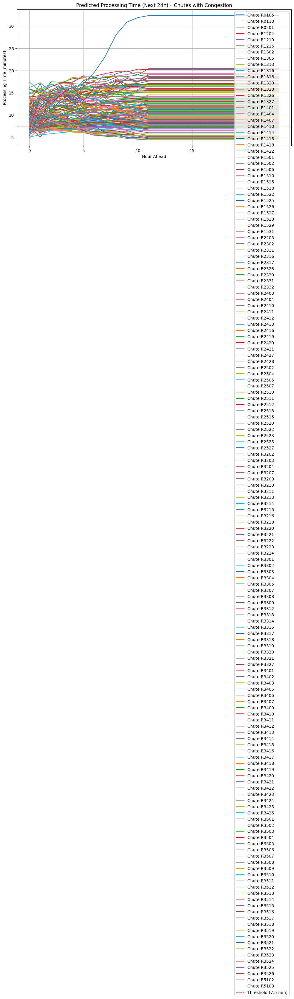

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt

# CONFIG
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
MODEL_PATH = 'enhanced_lstm_model.pt'
SEQUENCE_LENGTH = 12
PREDICTION_HORIZON = 24
CONGESTION_THRESHOLD = 7.5

# === LSTM MODEL CLASS ===
class EnhancedLSTM(nn.Module):
    def __init__(self, input_size, hidden_size=64):
        super(EnhancedLSTM, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True, num_layers=2, dropout=0.2)
        self.fc = nn.Sequential(
            nn.Linear(hidden_size, 64),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(64, 1)
        )

    def forward(self, x):
        out, _ = self.lstm(x)
        last = out[:, -1, :]
        return self.fc(last)

# === Load trained model ===
input_size = len(final_features)
model = EnhancedLSTM(input_size=input_size).to(DEVICE)
model.load_state_dict(torch.load(MODEL_PATH, map_location=DEVICE))
model.eval()

# === Inference for each chute ===
results = {}

for chute_id in enriched_df['CHUTE'].unique():
    df_chute = enriched_df[enriched_df['CHUTE'] == chute_id].copy()
    if len(df_chute) < SEQUENCE_LENGTH:
        continue

    df_chute = df_chute.sort_values('HOUR_TIME')
    X_chute = df_chute[final_features].copy()
    X_scaled = scaler_X.transform(X_chute)

    last_seq = X_scaled[-SEQUENCE_LENGTH:]
    last_seq = torch.tensor(last_seq, dtype=torch.float32).unsqueeze(0).to(DEVICE)

    future_preds = []
    for _ in range(PREDICTION_HORIZON):
        with torch.no_grad():
            pred = model(last_seq).item()
            future_preds.append(pred)

        # Repeat last input (for simulation)
        last_step = last_seq[0, -1, :].cpu().numpy()
        next_input = last_seq[0, 1:, :].cpu().numpy()
        next_input = np.vstack([next_input, last_step])
        last_seq = torch.tensor(next_input, dtype=torch.float32).unsqueeze(0).to(DEVICE)

    # Inverse transform predictions
    preds_rescaled = scaler_y.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()

    if np.any(preds_rescaled > CONGESTION_THRESHOLD):
        results[chute_id] = preds_rescaled

# === Plot congested chutes ===
if results:
    plt.figure(figsize=(12, 6))
    for chute_id, preds in results.items():
        plt.plot(preds, label=f'Chute {chute_id}')
    plt.axhline(CONGESTION_THRESHOLD, color='red', linestyle='--', label='Threshold (7.5 min)')
    plt.title("Predicted Processing Time (Next 24h) – Chutes with Congestion")
    plt.xlabel("Hour Ahead")
    plt.ylabel("Processing Time (minutes)")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("✅ No chutes predicted to exceed the congestion threshold.")


#"Upgraded" version of the LSTM Plots

<ipython-input-29-b066a66c519c>:79: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


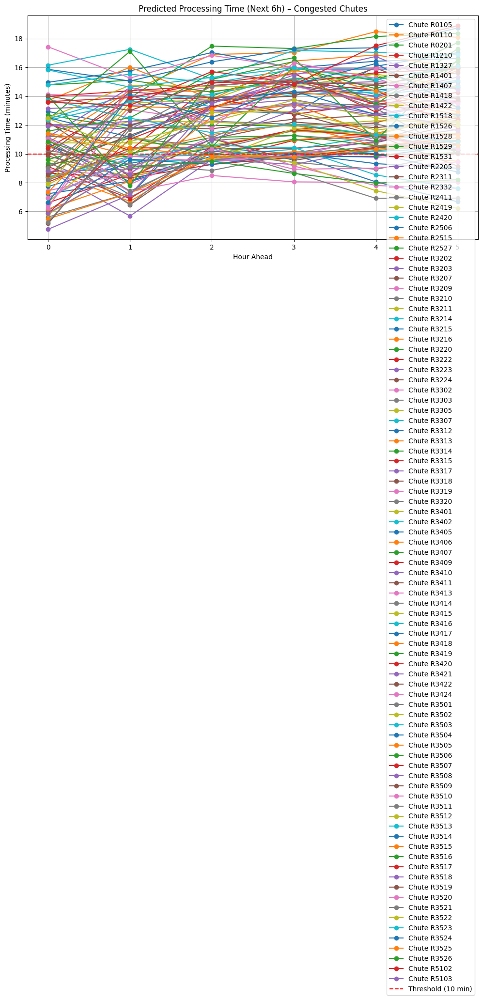

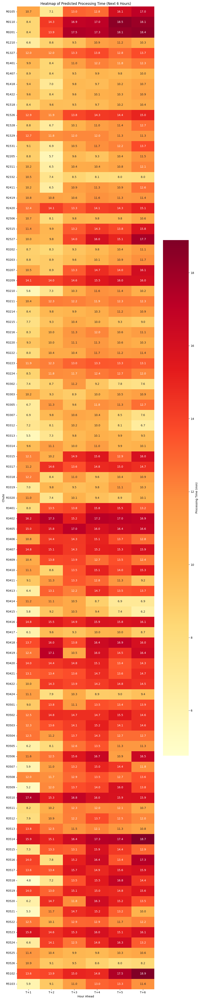

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# CONFIG
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
MODEL_PATH = 'enhanced_lstm_model.pt'
SEQUENCE_LENGTH = 12
PREDICTION_HORIZON = 6
CONGESTION_THRESHOLD = 10

# === LSTM MODEL CLASS ===
class EnhancedLSTM(torch.nn.Module):
    def __init__(self, input_size, hidden_size=64):
        super(EnhancedLSTM, self).__init__()
        self.lstm = torch.nn.LSTM(input_size, hidden_size, batch_first=True, num_layers=2, dropout=0.2)
        self.fc = torch.nn.Sequential(
            torch.nn.Linear(hidden_size, 64),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.2),
            torch.nn.Linear(64, 1)
        )

    def forward(self, x):
        out, _ = self.lstm(x)
        last = out[:, -1, :]
        return self.fc(last)

# === Load model ===
input_size = len(final_features)
model = EnhancedLSTM(input_size=input_size).to(DEVICE)
model.load_state_dict(torch.load(MODEL_PATH, map_location=DEVICE))
model.eval()

# === Predict for each chute ===
results = {}

for chute_id in enriched_df['CHUTE'].unique():
    df_chute = enriched_df[enriched_df['CHUTE'] == chute_id].copy()
    if len(df_chute) < SEQUENCE_LENGTH:
        continue

    df_chute = df_chute.sort_values('HOUR_TIME')
    X_chute = df_chute[final_features].copy()
    X_scaled = scaler_X.transform(X_chute)

    last_seq = X_scaled[-SEQUENCE_LENGTH:]
    last_seq = torch.tensor(last_seq, dtype=torch.float32).unsqueeze(0).to(DEVICE)

    future_preds = []
    for _ in range(PREDICTION_HORIZON):
        with torch.no_grad():
            pred = model(last_seq).item()
            future_preds.append(pred)

        # Simulate future input by repeating last known input
        last_step = last_seq[0, -1, :].cpu().numpy()
        next_input = last_seq[0, 1:, :].cpu().numpy()
        next_input = np.vstack([next_input, last_step])
        last_seq = torch.tensor(next_input, dtype=torch.float32).unsqueeze(0).to(DEVICE)

    preds_rescaled = scaler_y.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()

    if np.any(preds_rescaled > CONGESTION_THRESHOLD):
        results[chute_id] = preds_rescaled

# === Plot line chart for congested chutes ===
if results:
    plt.figure(figsize=(12, 6))
    for chute_id, preds in results.items():
        plt.plot(preds, marker='o', label=f'Chute {chute_id}')
    plt.axhline(CONGESTION_THRESHOLD, color='red', linestyle='--', label='Threshold (10 min)')
    plt.title("Predicted Processing Time (Next 6h) – Congested Chutes")
    plt.xlabel("Hour Ahead")
    plt.ylabel("Processing Time (minutes)")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # === Create Heatmap ===
    heatmap_data = np.array(list(results.values()))
    chute_labels = list(results.keys())
    plt.figure(figsize=(10, len(chute_labels) * 0.5 + 2))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".1f",
        cmap="YlOrRd",
        xticklabels=[f"T+{i+1}" for i in range(PREDICTION_HORIZON)],
        yticklabels=chute_labels,
        cbar_kws={'label': 'Processing Time (min)'}
    )
    plt.title("Heatmap of Predicted Processing Time (Next 6 Hours)")
    plt.xlabel("Hour Ahead")
    plt.ylabel("Chute")
    plt.tight_layout()
    plt.show()

else:
    print("✅ No chutes predicted to exceed the congestion threshold.")
